# **Airbnb Amenities & Feature Correlation Analysis**

## Goal: Analyze how features like number of beds, bathrooms, and amenities influence each other using correlation heatmaps, and identify insights that could inform property listing strategies.

## Table of contents


*   Step 1: Library/module importing
*   Step 2: Data collection and preprocessing
*   Step 3: Print and explore the data frame
*   Step 4: Analyze the data frame
*   Conclusatory summary





### **Step 1: Import libraries or modules, which are collections of pre-written code you can use so you don't have to reinvent the wheel.**

In [ ]:
import pandas as pd
import plotly.express as px
import numpy as np
import pickle
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
pip install pd

### **Step 2: Data collection and preprocessing**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# Mount Google Drive


# Replace with the actual path to your file in Google Drive
file_path = "/content/drive/MyDrive/airbnb 2.csv"


df = pd.read_csv(file_path)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
print(df.shape)

(12805, 23)


In [ ]:
df.info

<bound method DataFrame.info of        Unnamed: 0                  id  \
0               0            49849504   
1               1            50891766   
2               2            50699164   
3               3            49871422   
4               4            51245886   
5               5            48650769   
6               6            50765985   
7               7            40947216   
8               8            34043569   
9               9            42075682   
10             10            50425621   
11             11            46057058   
12             12            50689801   
13             13            53708687   
14             14            48325030   
15             15  620245309297447077   
16             16            48255254   
17             17  628273169113266405   
18             18            49982847   
19             19            48684568   
20             20            45231237   
21             21            50283577   
22             22            53809258   
23             23            52449114   
24             24            53192531   
25             25            53151582   
26             26  625932329535277910   
27             27  629647204973611229   
28             28            46794233   
29             29            22606080   
30             30            54323015   
31             31            49673016   
32             32            50458442   
33             33  614793135736222490   
34             34            53309759   
35             35  580261419619831357   
36             36  546619590761604346   
37             37  626028165124157941   
38             38  666617618674782773   
39             39            21082489   
40             40            30825825   
41             41            54301655   
42             42  610745734737149895   
43             43            44039103   
44             44            29717885   
45             45             1126224   
46             46  626359229528994415   
47             47  592431497070075673   
48             48            41617156   
49             49            50664527   
50             50            41362723   
51             51  679805160588663838   
52             52            44448191   
53             53            54336692   
54             54            34029409   
55             55             9583797   
56             56            49536360   
57             57            50298039   
58             58  633164191583346395   
59             59            49593232   
60             60            43481854   
61             61            42466759   
62             62            21689116   
63             63  636562135731372477   
64             64  548995415428144036   
65             65            22894844   
66             66            45745574   
67             67            51144177   
68             68  580411049389757922   
69             69            36106612   
70             70  559078149985188587   
71             71            42028668   
72             72            54050839   
73             73  589702167810700189   
74             74            34599587   
75             75            29862687   
76             76            40808568   
77             77            52379572   
78             78  551795401917046353   
79             79            54219732   
80             80            50499047   
81             81            51254413   
82             82  562138091801957973   
83             83            49242595   
84             84            49576819   
85             85  593801499660969808   
86             86            51123649   
87             87  559878930374905218   
88             88            42568790   
89             89            53265731   
90             90            54039900   
91             91            51120664   
92             92  563500410765814487   
93             93  630799913761573225   
94             94              940055   
95             95            502

### **Step 3: Print and explore the dataframe**

In [63]:
df =df.head(500)
df


,Unnamed: 0,id,name,rating,reviews,host_name,host_id,address,features,amenities,safety_rules,hourse_rules,img_links,price,country,bathrooms,beds,guests,toiles,bedrooms,studios,checkin,checkout,host_counts,num_guests,num_bedrooms,num_beds,private_bathroom,shared_bathroom,has_kitchen,has_wifi,has_dedicated_workspace,has_free_parking,has_waterfront,has_on-street_parking,has_garden_view,has_mountain_view
0,0,49849504,Perla bungalov,4.71,64,Mehmetcan,357334205.0,"Kartepe, Kocaeli, Turkey","2 guests,2 bedrooms,1 bed,1 bathroom","Mountain view,Valley view,Lake access,Kitchen,...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: Flexible,Check out: 12:00 pm,Pets ar...",https://a0.muscache.com/im/pictures/a5da5cb7-c...,8078,Turkey,1,1,2,0,2,0,Flexible,12 00 pm,1,2.0,2.0,NaN,0,0,1,1,0,1,0,0,0,1
1,1,50891766,Authentic Beach Architect Sheltered Villa with...,New,0,Fatih,386223873.0,"Kaş, Antalya, Turkey","4 guests,2 bedrooms,2 beds,2 bathrooms","Kitchen,Wifi,Dedicated workspace,Free parking ...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: 4:00 pm - 11:00 pm,Check out: 10:00 ...",https://a0.muscache.com/im/pictures/61b70855-2...,4665,Turkey,2,2,4,0,2,0,4 00 pm - 11 00 pm,10 00 am,7,4.0,2.0,2.0,0,0,1,1,1,1,0,0,0,0
2,2,50699164,cottages sataplia,4.85,68,Giorgi,409690853.0,"Imereti, Georgia","4 guests,1 bedroom,3 beds,1 bathroom","Mountain view,Kitchen,Wifi,Dedicated workspace...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: After 1:00 pm,Check out: 12:00 pm,Se...",https://a0.muscache.com/im/pictures/miso/Hosti...,5991,Georgia,1,3,4,0,1,0,After 1 00 pm,12 00 pm,1,4.0,1.0,3.0,0,0,1,1,1,0,0,0,0,1
3,3,49871422,Sapanca Breathable Bungalow,5.0,13,Melih,401873242.0,"Sapanca, Sakarya, Turkey","4 guests,1 bedroom,2 beds,1 bathroom","Mountain view,Valley view,Kitchen,Wifi,Free pa...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: After 2:00 pm,Check out: 12:00 pm,No...",https://a0.muscache.com/im/pictures/72e6396e-e...,11339,Turkey,1,2,4,0,1,0,After 2 00 pm,12 00 pm,1,4.0,1.0,2.0,0,0,1,1,0,1,0,0,0,1
4,4,51245886,Bungalov Ev 2,New,0,Arp Sapanca,414884116.0,"Sapanca, Sakarya, Turkey","2 guests,1 bedroom,1 bed,1 bathroom","Kitchen,Wifi,Free parking on premises,TV,Air c...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: After 2:00 pm,Check out: 12:00 pm,No...",https://a0.muscache.com/im/pictures/73973308-e...,6673,Turkey,1,1,2,0,1,0,After 2 00 pm,12 00 pm,1,2.0,1.0,NaN,0,0,1,1,0,1,0,0,0,0
5,5,48650769,CasaMia White Suite Treehouse,New,0,Casamia,261290482.0,"Sapanca, Sakarya, Turkey","2 guests,1 bedroom,2 beds,1 bathroom","Lake view,Mountain view,Waterfront,Wifi,Dedica...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: After 2:00 pm,Check out: 12:00 pm,No...",https://a0.muscache.com/im/pictures/miso/Hosti...,14729,Turkey,1,2,2,0,1,0,After 2 00 pm,12 00 pm,2,2.0,1.0,2.0,0,0,0,1,1,1,1,0,0,1
6,6,50765985,Ladin Bungalow,New,0,Stephen,15084529.0,"Kaş, Antalya, Turkey","2 guests,1 bedroom,1 bed,1 bathroom","Garden view,Mountain view,Kitchen,Wifi,Dedicat...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: After 3:00 pm,Check out: 11:00 am,No...",https://a0.muscache.com/im/pictures/prohost-ap...,12312,Turkey,1,1,2,0,1,0,After 3 00 pm,11 00 am,2,2.0,1.0,NaN,0,0,1,1,1,1,0,0,1,1
7,7,40947216,Lavender House,New,0,Caner,318794897.0,"Akçalı, Giresun, Turkey","8 guests,1 bedroom,2 beds,1 bathroom","Wifi,Dedicated workspace,Free parking on premi...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: Flexible,Self check-in with building...",https://a0.muscache.com/im/pictures/97046585-1...,13655,Turkey,1,2,8,0,1,0,Flexible,NaN,1,8.0,1.0,2.0,0,0,0,1,1,1,0,0,0,0
8,8,34043569,Prince's,New,0,Tu,221057563.0,"Thành phố Đà Lạt, Lâm Đồng, Vietnam","2 guests,1 bedroom,1 bed,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: After 1:00 pm,Check out: 11:00 am,Se...",https://a0.muscache

In [ ]:
df.describe()

,Unnamed: 0,id,host_id,price,bathrooms,beds,guests,toiles,bedrooms,studios
count,12805.000000,1.280500e+04,1.280500e+04,1.280500e+04,12805.000000,12805.000000,12805.000000,12805.000000,12805.000000,12805.000000
mean,6402.000000,7.525187e+16,1.638192e+08,1.769780e+04,1.874424,3.316751,5.213745,0.019211,2.136041,0.023585
std,3696.629433,2.007933e+17,1.413622e+08,4.569364e+04,2.091399,4.037791,3.808830,0.137272,2.359005,0.151757
min,0.000000,1.313100e+04,2.303900e+04,3.930000e+02,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,3201.000000,2.023958e+07,3.700032e+07,3.994000e+03,1.000000,1.000000,2.000000,0.000000,1.000000,0.000000
50%,6402.000000,3.682229e+07,1.256459e+08,8.175000e+03,1.000000,2.000000,4.000000,0.000000,1.000000,0.000000
75%,9603.000000,4.999760e+07,2.639623e+08,1.606200e+04,2.000000,4.000000,6.000000,0.000000,3.000000,0.000000
max,12804.000000,7.017905e+17,4.758973e+08,1.907963e+06,50.000000,98.000000,16.000000,1.000000,50.000000,1.000000


In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
df.iloc[:, 1:3]

,id,name
0,49849504,Perla bungalov
1,50891766,Authentic Beach Architect Sheltered Villa with...
2,50699164,cottages sataplia
3,49871422,Sapanca Breathable Bungalow
4,51245886,Bungalov Ev 2
5,48650769,CasaMia White Suite Treehouse
6,50765985,Ladin Bungalow
7,40947216,Lavender House
8,34043569,Prince's
9,42075682,"The Cottage, Private Pool Villa"


### **Step 4: Analyze the data frame**

In [ ]:
df.repeat_hosts = df['name'].value_counts()[df['name'].value_counts() > 1]
df.repeat_hosts



<ipython-input-54-b341a56c72a0>:1: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  df.repeat_hosts = df['name'].value_counts()[df['name'].value_counts() > 1]


,count
name,
Dorm Bed in Traditional Ger - Mongol Ujin Camp,6
Haveli - Large room in Art & Book filled mansion!,5
The goat village Nagtibba By Bakri Chhap,4
"InnerX-Stay, Floating Homestay in Lan Ha bay",4
Comfort room with breakfast included,3
The Long Road | Time-out in a mountain art house,3
"InnerX-Stay, floating Homestay in Lan Ha bay",3
Penghu Magong Destination Inn - Double Room,3
Deniz Manzaralı 'Lüks 'Glamping' Özel Havuzlu,3


In [ ]:
df['host_counts'] = df['host_id'].map(df['host_id'].value_counts())

filtered_df = df[df['host_counts'] > 15]

filtered_df

,Unnamed: 0,id,name,rating,reviews,host_name,host_id,address,features,amenities,safety_rules,hourse_rules,img_links,price,country,bathrooms,beds,guests,toiles,bedrooms,studios,checkin,checkout,host_counts
1190,1190,601816645157829673,Stone Cottage,4.6,5,Shanu,157378426.0,"Jibhi, Himachal Pradesh, India","4 guests,1 bedroom,2 beds,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free on-stree...","󹀁,Airbnb's COVID-19 safety practices apply,Car...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/miso/Hosti...,2852,India,1,2,4,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
1544,1544,628897626500350545,Blissful cottage in the woods| Tandi,New,2,Shanu,157378426.0,"Tandi, Himachal Pradesh, India","2 guests,1 bedroom,1 bed,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/miso/Hosti...,4564,India,1,1,2,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
1557,1557,45644216,Beautiful Sunny Cottage|250 meter Trek| Jibhi,4.85,41,Shanu,157378426.0,"Jibhi, Himachal Pradesh, India","6 guests,2 bedrooms,3 beds,1 bathroom","Waterfront,Wifi,Dedicated workspace,Free on-st...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/1c85e281-2...,2281,India,1,3,6,0,2,0,12 00 pm - 10 00 pm,11 00 am,28
1561,1561,636631343388002719,Entire cottage with a room & attic in Tandi,New,1,Shanu,157378426.0,"Jibhi, Himachal Pradesh, India","4 guests,1 bedroom,1 bed,1 bathroom","Wifi,Dedicated workspace,Free parking on premi...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/miso/Hosti...,2853,India,1,1,4,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
1571,1571,614293947503916670,Wooden hut with the Valley view in jibhi,New,2,Shanu,157378426.0,"Jibhi, Himachal Pradesh, India","4 guests,1 bedroom,1 bed,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/miso/Hosti...,2281,India,1,1,4,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
1614,1614,616569469785545211,Peaceful Haven in an Apple Orchard,New,1,Shanu,157378426.0,"Jibhi, Himachal Pradesh, India","4 guests,1 bedroom,1 bed,1 bathroom","Waterfront,Wifi,Dedicated workspace,Free parki...","󹀁,Airbnb's COVID-19 safety practices apply,󱠃,N...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/8dd28c01-6...,3422,India,1,1,4,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
3080,3080,52505611,A Mudhouse In A Resort| Chhet,New,0,Shanu,157378426.0,"Banjar, Himachal Pradesh, India","4 guests,1 bedroom,1 bed,1 bathroom","Dedicated workspace,Free parking on premises,P...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: 12:00 pm - 10:00 pm,Pets are allowed...",https://a0.muscache.com/im/pictures/7289076b-9...,5705,India,1,1,4,0,1,0,12 00 pm - 10 00 pm,NaN,28
3142,3142,52162851,Vibrant Room In A Beautiful Cottage| Hatu Peak,New,0,Shanu,157378426.0,"Narkanda, Himachal Pradesh, India","5 guests,1 bedroom,2 beds,1 shared bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...","󹀁,Airbnb's COVID-19 safety practices apply,󱠆,C...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/b62a917c-3...,5706,India,1,2,5,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
5276,5276,578733555164036351,Magnificent Treehouse with Valley View| Tandi,4.73,11,Shanu,157378426.0,"Jibhi, Himachal Pradesh, India","3 guests,1 bedroom,2 beds,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...","󹀁,Airbnb's COVID-19 safety practices apply,Car...","Check-in: 12:00 pm - 10:00 pm,Check out: 11:00...",https://a0.muscache.com/im/pictures/miso/Hosti...,3422,India,1,2,3,0,1,0,12 00 pm - 10 00 pm,11 00 am,28
5284,

In [ ]:

host_counts= df['name'].value_counts()
host_counts


,count
name,
Dorm Bed in Traditional Ger - Mongol Ujin Camp,6
Haveli - Large room in Art & Book filled mansion!,5
The goat village Nagtibba By Bakri Chhap,4
"InnerX-Stay, Floating Homestay in Lan Ha bay",4
Comfort room with breakfast included,3
The Long Road | Time-out in a mountain art house,3
"InnerX-Stay, floating Homestay in Lan Ha bay",3
Penghu Magong Destination Inn - Double Room,3
Deniz Manzaralı 'Lüks 'Glamping' Özel Havuzlu,3


In [ ]:
sum_df = filtered_df.iloc[:, [2, 8 ,9, 23]]
sum_df

,name,features,amenities,host_counts
1190,Stone Cottage,"4 guests,1 bedroom,2 beds,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free on-stree...",28
1544,Blissful cottage in the woods| Tandi,"2 guests,1 bedroom,1 bed,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...",28
1557,Beautiful Sunny Cottage|250 meter Trek| Jibhi,"6 guests,2 bedrooms,3 beds,1 bathroom","Waterfront,Wifi,Dedicated workspace,Free on-st...",28
1561,Entire cottage with a room & attic in Tandi,"4 guests,1 bedroom,1 bed,1 bathroom","Wifi,Dedicated workspace,Free parking on premi...",28
1571,Wooden hut with the Valley view in jibhi,"4 guests,1 bedroom,1 bed,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...",28
1614,Peaceful Haven in an Apple Orchard,"4 guests,1 bedroom,1 bed,1 bathroom","Waterfront,Wifi,Dedicated workspace,Free parki...",28
3080,A Mudhouse In A Resort| Chhet,"4 guests,1 bedroom,1 bed,1 bathroom","Dedicated workspace,Free parking on premises,P...",28
3142,Vibrant Room In A Beautiful Cottage| Hatu Peak,"5 guests,1 bedroom,2 beds,1 shared bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...",28
5276,Magnificent Treehouse with Valley View| Tandi,"3 guests,1 bedroom,2 beds,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...",28
5284,Picturesque Treehouse | Tandi,"4 guests,1 bedroom,2 beds,1 bathroom","Kitchen,Wifi,Dedicated workspace,Free parking ...",28


In [ ]:
has_duplicates = df.duplicated().any()
has_duplicates

np.False_

In [ ]:
df.isnull().sum()

,0
Unnamed: 0,0
id,0
name,0
rating,0
reviews,0
host_name,8
host_id,0
address,0
features,0
amenities,0


### **Step 5: Visualize the correlation matrix**

Question: What is the correlation between features and the frequency of guests?





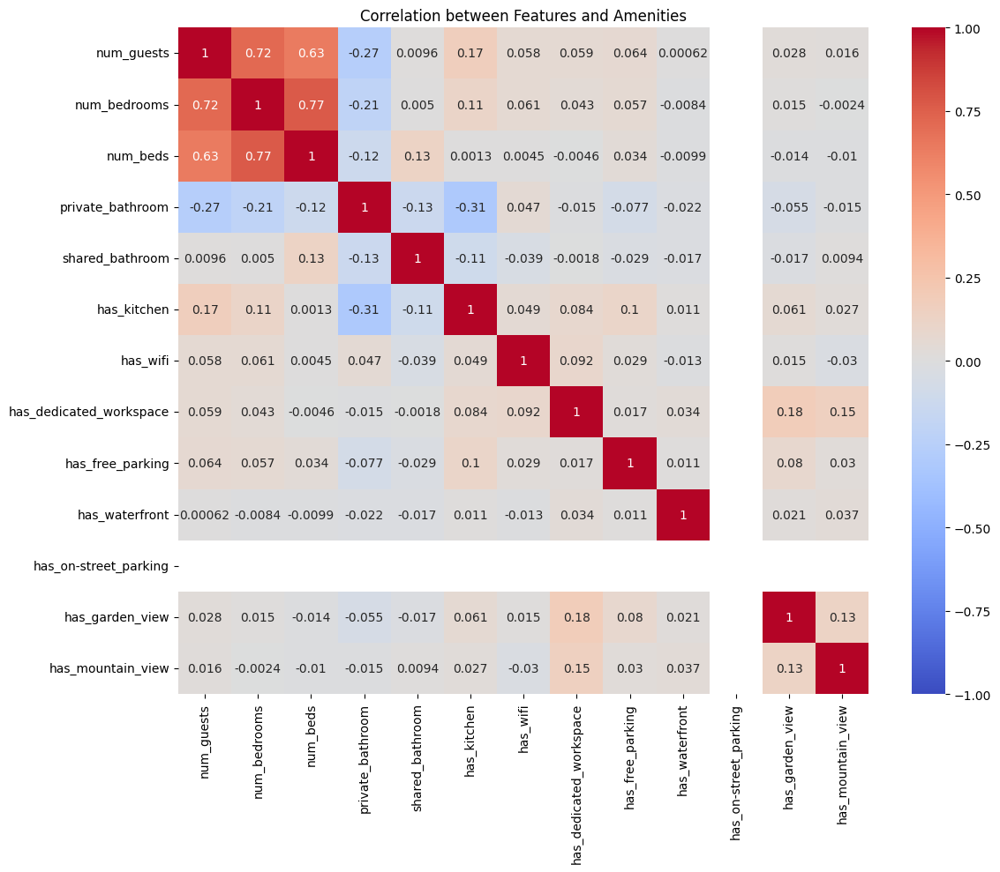

In [ ]:
# Parse the features column into separate attributes
# Extract number of guests, bedrooms, beds, bathroom types
df['num_guests'] = df['features'].str.extract(r'(\d+) guests').astype(float)
df['num_bedrooms'] = df['features'].str.extract(r'(\d+) bedroom').astype(float)
df['num_beds'] = df['features'].str.extract(r'(\d+) beds').astype(float)
df['private_bathroom'] = df['features'].str.contains('private bathroom').astype(int)
df['shared_bathroom'] = df['features'].str.contains('shared bathroom').astype(int)

# Parse amenities into binary columns
amenity_types = ['Kitchen', 'Wifi', 'Dedicated workspace', 'Free parking',
                'Waterfront', 'On-street parking', 'Garden view', 'Mountain view']

for amenity in amenity_types:
    df[f'has_{amenity.lower().replace(" ", "_")}'] = df['amenities'].str.contains(amenity).astype(int)

# Calculate correlation between features and amenities
feature_cols = ['num_guests', 'num_bedrooms', 'num_beds', 'private_bathroom', 'shared_bathroom']
amenity_cols = [f'has_{amenity.lower().replace(" ", "_")}' for amenity in amenity_types]

# Create a correlation matrix
correlation_matrix = df[feature_cols + amenity_cols].corr()

# Save the correlation data using pickle
with open('feature_amenity_correlation.pkl', 'wb') as f:
    pickle.dump(correlation_matrix, f)

# Visualize the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation between Features and Amenities')
plt.tight_layout()
plt.savefig('feature_amenity_correlation.png')
plt.show()


## **Conclusatory summary**


✅ **Learnings**


* Core features like number of guests, bedrooms, and beds are strongly correlated, indicating that listings scale in tandem across these attributes.

* Amenities like Wi-Fi, kitchen, and dedicated workspace show weak or no correlation with layout-based features, suggesting that they are independent choices made by hosts rather than tied to property size.

* Notably, 19 of the 28 most frequently booked listings accommodate 4 or more guests, indicating that larger listings may attract higher booking volume, especially for group or family travel.

* Weak or zero correlation among amenities (e.g., garden view, on-street parking) implies that location-specific amenities do not scale predictably with property layout.

🔍** What Could Be Done Next**

* Regression analysis: Predict pricing or booking frequency based on feature and amenity combinations.

* Clustering: Group listings by feature/amenity profiles to identify market segments (e.g., budget-friendly vs. remote work–optimized properties).

* Time-series analysis: Track how amenity preferences or price trends evolve over time across regions.

* Sentiment or review analysis: Explore if feature-rich listings correlate with higher ratings or review sentiment.

🌍 **Real-World Implications**
* Hosts may benefit from adding high-value amenities (like Wi-Fi, workspace) regardless of listing size, since they’re independent levers that improve appeal.

* Listings designed for larger groups could increase booking frequency, making multi-room properties potentially more profitable.

* Investors and property managers can use correlation insights to strategically upgrade properties and tailor offerings to match booking patterns and guest expectations.